# Analysis of Environmental Metrics

In [29]:
import pandas as pd
import numpy as np
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.colors as colors
import matplotlib.patches as mpatches
from pandas import cut
from matplotlib import colormaps as cmap
import folium
from shapely.ops import unary_union
import plotly.express as px


%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 8)
plt.style.use("ggplot")

In [30]:
env_cols = [
    'Census tract 2010 ID', 
    'County Name', 
    'State/Territory',
    'Total population', 
    'Percent American Indian / Alaska Native', 
    'Percent Asian', 'Percent Black or African American alone', 
    'Percent Hispanic or Latino', 
    'Percent Native Hawaiian or Pacific',
    'Percent other races', 
    'Percent White',
    'Energy burden',
    'Energy burden (percentile)',
    'Percent pre-1960s housing (lead paint indicator)',
    'Percent pre-1960s housing (lead paint indicator) (percentile)',
    'PM2.5 in the air',
    'PM2.5 in the air (percentile)',
    'Proximity to hazardous waste sites (percentile)',
    'Share of properties at risk of flood in 30 years (percentile)',
    'Proximity to Risk Management Plan (RMP) facilities (percentile)',
    'Share of properties at risk of fire in 30 years (percentile)'
]   

env_stats = pd.read_csv(r"C:\\New_499_Code\\499_Cleaned_Abbreviated_CEJST_Disadvantaged_Communities_Data.csv", usecols=env_cols)

In [31]:
#aggregate the data to the county level 
env_stats = env_stats.groupby(['County Name', 'State/Territory']).mean().reset_index()
env_stats.head(2)

,County Name,State/Territory,Census tract 2010 ID,Percent Black or African American alone,Percent American Indian / Alaska Native,Percent Asian,Percent Native Hawaiian or Pacific,Percent White,Percent Hispanic or Latino,Percent other races,...,Share of properties at risk of flood in 30 years (percentile),Share of properties at risk of fire in 30 years (percentile),Energy burden (percentile),Energy burden,PM2.5 in the air (percentile),PM2.5 in the air,Percent pre-1960s housing (lead paint indicator) (percentile),Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile)
0,Abbeville County,South Carolina,4.500195e+10,0.256667,0.000000,0.001667,0.0,0.698333,0.008333,0.000000,...,29.833333,45.5,90.666667,5.166667,35.666667,8.076667,52.500000,27.166667,25.666667,28.000000
1,Acadia Parish,Louisiana,2.200196e+10,0.171667,0.000833,0.000000,0.0,0.769167,0.020833,0.001667,...,84.666667,33.0,69.666667,3.583333,62.416667,8.996667,47.166667,23.083333,19.416667,51.583333


In [32]:
CEJST_shapefile_path = r"C:\New_499_Code\assets\cb_2021_us_tract_500k\cb_2021_us_tract_500k.shp"
CEJST_Shapefile = gpd.read_file(CEJST_shapefile_path)
CEJST_Shapefile.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,13,163,960300,1400000US13163960300,13163960300,9603,Census Tract 9603,GA,Jefferson County,Georgia,CT,564728206,4845400,"POLYGON ((-82.66192 33.12633, -82.65194 33.126..."
1,37,109,071201,1400000US37109071201,37109071201,712.01,Census Tract 712.01,NC,Lincoln County,North Carolina,CT,5976613,6611763,"POLYGON ((-80.99344 35.47878, -80.99142 35.480..."


In [33]:
# Filter the GeoDataFrame because it takes 20 minutes to run otherwise
filtered_CEJST_Shapefile = CEJST_Shapefile[CEJST_Shapefile['STATE_NAME'].isin(['Tennessee'])]
filtered_CEJST_Shapefile.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
361,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,CT,2272173,0,"POLYGON ((-86.71746 36.12302, -86.71703 36.123..."
542,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,CT,2315123,0,"POLYGON ((-82.36523 36.30877, -82.36357 36.309..."


In [34]:
#merge the environmental data with the shapefile
env_stats = filtered_CEJST_Shapefile.merge(env_stats, left_on='NAMELSADCO', right_on='County Name', how='left')
env_stats.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,Share of properties at risk of flood in 30 years (percentile),Share of properties at risk of fire in 30 years (percentile),Energy burden (percentile),Energy burden,PM2.5 in the air (percentile),PM2.5 in the air,Percent pre-1960s housing (lead paint indicator) (percentile),Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile)
0,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,39.764706,35.029412,58.558824,3.029412,56.676471,8.801176,40.735294,18.823529,43.058824,43.264706
1,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,56.086957,33.000000,43.734177,2.354430,47.496894,8.497267,43.211180,23.608696,44.583851,58.142857


In [35]:
env_stats.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME',
       'NAMELSAD', 'STUSPS', 'NAMELSADCO', 'STATE_NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'County Name', 'State/Territory',
       'Census tract 2010 ID', 'Percent Black or African American alone',
       'Percent American Indian / Alaska Native', 'Percent Asian',
       'Percent Native Hawaiian or Pacific', 'Percent White',
       'Percent Hispanic or Latino', 'Percent other races', 'Total population',
       'Share of properties at risk of flood in 30 years (percentile)',
       'Share of properties at risk of fire in 30 years (percentile)',
       'Energy burden (percentile)', 'Energy burden',
       'PM2.5 in the air (percentile)', 'PM2.5 in the air',
       'Percent pre-1960s housing (lead paint indicator) (percentile)',
       'Percent pre-1960s housing (lead paint indicator)',
       'Proximity to hazardous waste sites (percentile)',
       'Proximity to Risk Management Plan (RMP) facilities (perc

## Section 1: Energy Burden
Energy burden measures the percentage of household income spent on energy costs, highlighting economic disparities. 

### Key Findings:

The mean energy burden was analyzed for racial groups across counties, including:
Black or African American
White
Hispanic or Latino
Asian
American Indian or Alaska Native
Variations in energy burden reflect systemic disparities in energy costs, with some racial groups disproportionately affected.

In [36]:
# Convert relevant columns to numeric types
env_stats['Energy burden'] = pd.to_numeric(env_stats['Energy burden'], errors='coerce')
env_stats['Percent American Indian / Alaska Native'] = pd.to_numeric(env_stats['Percent American Indian / Alaska Native'], errors='coerce')
env_stats['Percent Asian'] = pd.to_numeric(env_stats['Percent Asian'], errors='coerce')
env_stats['Percent Black or African American alone'] = pd.to_numeric(env_stats['Percent Black or African American alone'], errors='coerce')
env_stats['Percent Hispanic or Latino'] = pd.to_numeric(env_stats['Percent Hispanic or Latino'], errors='coerce')
env_stats['Percent Native Hawaiian or Pacific'] = pd.to_numeric(env_stats['Percent Native Hawaiian or Pacific'], errors='coerce')
env_stats['Percent other races'] = pd.to_numeric(env_stats['Percent other races'], errors='coerce')
env_stats['Percent White'] = pd.to_numeric(env_stats['Percent White'], errors='coerce')

# Calculate the mean energy burden per race per county and add them as columns to the dataframe
env_stats['Mean Energy Burden for American Indian/Alaska Native'] = env_stats['Energy burden'] * env_stats['Percent American Indian / Alaska Native'] / 100 
env_stats['Mean Energy Burden for Asian'] = env_stats['Energy burden'] * env_stats['Percent Asian'] / 100
env_stats['Mean Energy Burden for Black or African American'] = env_stats['Energy burden'] * env_stats['Percent Black or African American alone'] / 100
env_stats['Mean Energy Burden for Hispanic or Latino'] = env_stats['Energy burden'] * env_stats['Percent Hispanic or Latino'] / 100
env_stats['Mean Energy Burden for Native Hawaiian or Pacific'] = env_stats['Energy burden'] * env_stats['Percent Native Hawaiian or Pacific'] / 100
env_stats['Mean Energy Burden for other races'] = env_stats['Energy burden'] * env_stats['Percent other races'] / 100
env_stats['Mean Energy Burden for White'] = env_stats['Energy burden'] * env_stats['Percent White'] / 100

env_stats.head()

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile),Mean Energy Burden for American Indian/Alaska Native,Mean Energy Burden for Asian,Mean Energy Burden for Black or African American,Mean Energy Burden for Hispanic or Latino,Mean Energy Burden for Native Hawaiian or Pacific,Mean Energy Burden for other races,Mean Energy Burden for White
0,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,18.823529,43.058824,43.264706,0.000045,0.000392,0.002905,0.002129,0.000000,0.000374,0.023817
1,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,23.608696,44.583851,58.142857,0.000018,0.000706,0.006393,0.002267,0.000009,0.000428,0.013108
2,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,16.000000,12.800000,22.000000,0.002352,0.000000,0.009408,0.000588,0.000000,0.000000,0.027888
3,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,11.468750,48.750000,57.187500,0.000112,0.000415,0.000640,0.003488,0.000394,0.002088,0.016249
4,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,52.000000,2.500000,56.500000,0.000000,0.000000,0.000225,0.003825,0.000000,0.000225,0.039375


In [37]:
#check to see if env_stats is a geoDataFrame
type(env_stats)

geopandas.geodataframe.GeoDataFrame

In [38]:
#convert env_stats to a GeoDataFrame
env_stats = gpd.GeoDataFrame(env_stats)
env_stats_filtered = env_stats[env_stats['STATE_NAME'] == 'Tennessee']
#check crs
print(env_stats.crs)

EPSG:4269


In [39]:
#save env_stats to a csv
env_stats.to_csv(r"C:\\New_499_Code\\env_stats.csv")

In [40]:
# m = env_stats.explore(
#     column="Mean Energy Burden for Black or African American",
#     scheme="fisherjenks", 
#     legend=False, 
#     k=5, 
#     tooltip=False, 
#     popup=['NAMELSADCO', 'Mean Energy Burden for Black or African American'],
#     legend_kwds=dict(colorbar=False),  
#     name="Energy Burden",  
# )

# folium.TileLayer("CartoDB positron", show=False).add_to(
#     m
# )  
# folium.LayerControl().add_to(m)  
# m

C:\Users\Kassidi\AppData\Local\Temp\ipykernel_14472\1492192832.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=env_stats,


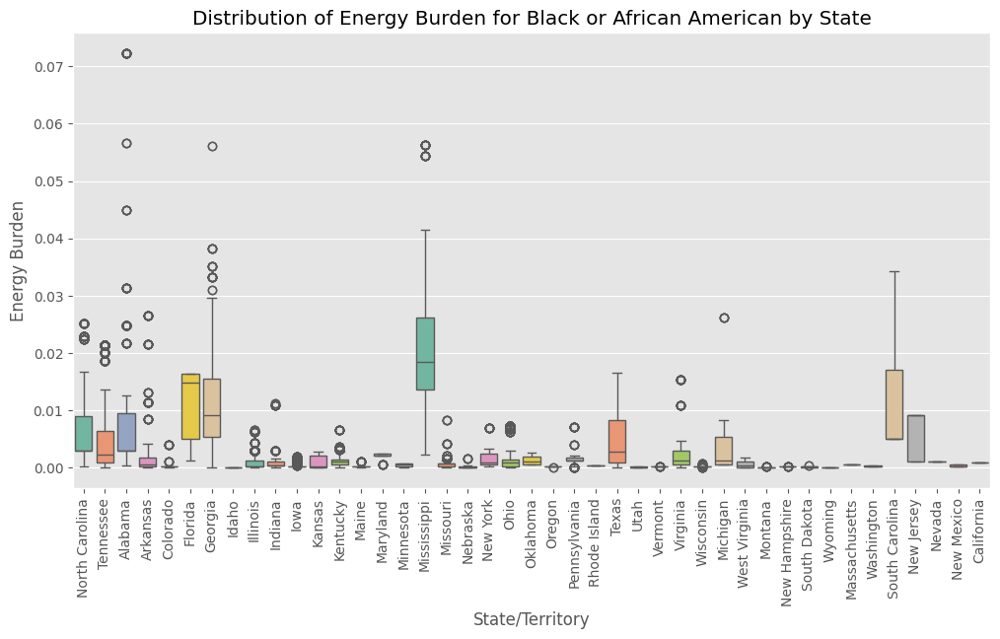

In [41]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=env_stats, 
            x='State/Territory', 
            y='Mean Energy Burden for Black or African American', 
            palette='Set2')
plt.xticks(rotation=90)
plt.title('Distribution of Energy Burden for Black or African American by State')
plt.ylabel('Energy Burden')
plt.xlabel('State/Territory')
plt.show()


In [42]:
import plotly.express as px

# Update data with shortened names for x-axis
parallel_data = env_stats[['State/Territory', 
                           'Mean Energy Burden for Black or African American',
                           'Mean Energy Burden for White',
                           'Mean Energy Burden for Hispanic or Latino',
                           'Mean Energy Burden for Asian',
                           'Mean Energy Burden for American Indian/Alaska Native', 
                           'Mean Energy Burden for Native Hawaiian or Pacific',
                           'Total population']]
parallel_data = parallel_data.melt(id_vars='State/Territory', 
                                   var_name='Racial Group', 
                                   value_name='Energy Burden')

# Shorten the x-axis labels
parallel_data['Racial Group'] = parallel_data['Racial Group'].str.replace('Mean Energy Burden for ', '', regex=False)

# Plot interactive parallel coordinates using plotly
fig = px.line(
    parallel_data, 
    x='Racial Group', 
    y='Energy Burden', 
    color='State/Territory', 
    title='Mean Energy Burden Across Racial Groups',
    hover_data={'Energy Burden': ':.2f', 'State/Territory': True},  # Display energy burden to 2 decimal places
    line_group='State/Territory'
)

# Update layout for size and black background
fig.update_layout(
    title_font_size=24,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font_color='white',
    width=1400,  # Increase plot width
    height=800,  # Increase plot height
    xaxis=dict(tickangle=45)  # Rotate x-axis labels
)

fig.show()


In [ ]:
env_stats['Black Population'] = (env_stats['Percent Black or African American alone'] / 100) * env_stats['Total population']
env_stats['White Population'] = (env_stats['Percent White'] / 100) * env_stats['Total population']
env_stats['Hispanic Population'] = (env_stats['Percent Hispanic or Latino'] / 100) * env_stats['Total population']
env_stats['Asian Population'] = (env_stats['Percent Asian'] / 100) * env_stats['Total population']
env_stats['American Indian Population'] = (env_stats['Percent American Indian / Alaska Native'] / 100) * env_stats['Total population']


env_stats['Normalized Energy Burden for Black'] = env_stats['Mean Energy Burden for Black or African American'] / env_stats['Black Population']
env_stats['Normalized Energy Burden for White'] = env_stats['Mean Energy Burden for White'] / env_stats['White Population']
env_stats['Normalized Energy Burden for Hispanic'] = env_stats['Mean Energy Burden for Hispanic or Latino'] / env_stats['Hispanic Population']
env_stats['Normalized Energy Burden for Asian'] = env_stats['Mean Energy Burden for Asian'] / env_stats['Asian Population']
env_stats['Normalized Energy Burden for American Indian'] = env_stats['Mean Energy Burden for American Indian/Alaska Native'] / env_stats['American Indian Population']


normalized_data = env_stats[['NAMELSADCO', 
                             'Normalized Energy Burden for Black',
                             'Normalized Energy Burden for White',
                             'Normalized Energy Burden for Hispanic',
                             'Normalized Energy Burden for Asian',
                             'Normalized Energy Burden for American Indian']]
normalized_data = normalized_data.melt(id_vars='NAMELSADCO', 
                                       var_name='Racial Group', 
                                       value_name='Normalized Energy Burden')


normalized_data['Racial Group'] = normalized_data['Racial Group'].str.replace('Normalized Energy Burden for ', '', regex=False)

import plotly.express as px
fig = px.line(
    normalized_data, 
    x='Racial Group', 
    y='Normalized Energy Burden', 
    color='NAMELSADCO', 
    title='Normalized Energy Burden Across Racial Groups (Tennessee Counties)',
    hover_name='NAMELSADCO',
    line_group='NAMELSADCO'
)

fig.update_layout(
    title_font_size=24,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font_color='white',
    width=1400,
    height=800,
    xaxis=dict(tickangle=45)
)

fig.show()


# Creating an Overall Weighted Environmental Score Based On All Relevant Variables 

In [ ]:
from sklearn.preprocessing import MinMaxScaler
env_data = env_stats.applymap(lambda x: 1 if x is True else (0 if x is False else x))

# scaling values between 0 and 1
scaler = MinMaxScaler()

columns_to_scale = [
    'Energy burden',
    'Percent pre-1960s housing (lead paint indicator)',
    'PM2.5 in the air',
    'Proximity to hazardous waste sites (percentile)',
    'Share of properties at risk of flood in 30 years (percentile)',
    'Proximity to Risk Management Plan (RMP) facilities (percentile)',
    'Share of properties at risk of fire in 30 years (percentile)'
]

# apply the MinMaxScaler to the columns
env_data[columns_to_scale] = scaler.fit_transform(env_data[columns_to_scale])
                                                                                                                                                                      
# Calculating the Environmental Score by combining the scaled metrics
# Using equal weights for now; this can be adjusted based on importance
env_data['Environmental Score'] = (
    env_data['Energy burden'] +
    env_data['Percent pre-1960s housing (lead paint indicator)'] +
    env_data['PM2.5 in the air'] +
    env_data['Proximity to hazardous waste sites (percentile)'] +
    env_data['Share of properties at risk of flood in 30 years (percentile)'] +
    env_data['Proximity to Risk Management Plan (RMP) facilities (percentile)'] +
    env_data['Share of properties at risk of fire in 30 years (percentile)']
) / 7  

print(env_data[['Census tract 2010 ID', 'County Name', 'Environmental Score']])

       Census tract 2010 ID        County Name  Environmental Score
0              3.705706e+10    Davidson County             0.357643
1              4.703703e+10    Davidson County             0.397382
2              1.129044e+09  Washington County             0.451609
3              5.143011e+09  Washington County             0.405475
4              8.121924e+09  Washington County                  NaN
...                     ...                ...                  ...
11797          3.711501e+10     Madison County             0.412970
11798          3.909704e+10     Madison County             0.354139
11799          4.711300e+10     Madison County             0.368463
11800          4.831300e+10     Madison County             0.407000
11801          5.111393e+10     Madison County             0.300710

[11802 rows x 3 columns]


C:\Users\Kassidi\AppData\Local\Temp\ipykernel_14472\3774103437.py:2: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



In [ ]:
from shapely.ops import unary_union
import geopandas as gpd

env_stats_copy = env_data.copy()

env_stats_copy['UniqueID'] = env_stats_copy['County Name'] + ', ' + env_stats_copy['State/Territory']

env_stats_copy = env_stats_copy.groupby('UniqueID').agg(
    {
        # Non-aggregated columns: retain the first occurrence
        'County Name': 'first',
        'State/Territory': 'first',
        'Total population': 'first',
        'Percent American Indian / Alaska Native': 'first',
        'Percent Asian': 'first',
        'Percent Black or African American alone': 'first',
        'Percent Hispanic or Latino': 'first',
        'Percent Native Hawaiian or Pacific': 'first',
        'Environmental Score': 'mean', 
        'geometry': lambda x: unary_union(x), 
        'Energy burden': 'mean',  
        'Energy burden (percentile)': 'mean',  
        'Percent pre-1960s housing (lead paint indicator)': 'first',
        'PM2.5 in the air': 'mean',  
        'Proximity to hazardous waste sites (percentile)': 'mean', 
        'Share of properties at risk of flood in 30 years (percentile)': 'mean', 
        'Proximity to Risk Management Plan (RMP) facilities (percentile)': 'mean',  
        'Share of properties at risk of fire in 30 years (percentile)': 'mean', 
    }
).reset_index()

env_stats_copy = gpd.GeoDataFrame(env_stats_copy, geometry='geometry')

Index(['UniqueID', 'County Name', 'State/Territory', 'Total population',
       'Percent American Indian / Alaska Native', 'Percent Asian',
       'Percent Black or African American alone', 'Percent Hispanic or Latino',
       'Percent Native Hawaiian or Pacific', 'Environmental Score', 'geometry',
       'Energy burden', 'Energy burden (percentile)',
       'Percent pre-1960s housing (lead paint indicator)', 'PM2.5 in the air',
       'Proximity to hazardous waste sites (percentile)',
       'Share of properties at risk of flood in 30 years (percentile)',
       'Proximity to Risk Management Plan (RMP) facilities (percentile)',
       'Share of properties at risk of fire in 30 years (percentile)'],
      dtype='object')


In [46]:
env_stats_copy.columns

Index(['UniqueID', 'County Name', 'State/Territory', 'Total population',
       'Percent American Indian / Alaska Native', 'Percent Asian',
       'Percent Black or African American alone', 'Percent Hispanic or Latino',
       'Percent Native Hawaiian or Pacific', 'Environmental Score', 'geometry',
       'Energy burden', 'Energy burden (percentile)',
       'Percent pre-1960s housing (lead paint indicator)', 'PM2.5 in the air',
       'Proximity to hazardous waste sites (percentile)',
       'Share of properties at risk of flood in 30 years (percentile)',
       'Proximity to Risk Management Plan (RMP) facilities (percentile)',
       'Share of properties at risk of fire in 30 years (percentile)'],
      dtype='object')

In [ ]:
county_env_map = env_stats_copy.set_geometry('geometry') 

# Create the map with the first layer (Environmental Score)
county_env_map = env_stats_copy.explore(
    column="Environmental Score",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'Environmental Score'],
    legend_kwds=dict(colorbar=False),  
    name="Environmental Score",  
    width="80%",  
    height="500px"  
)

folium.TileLayer("CartoDB positron", show=False).add_to(county_env_map)

# Add the second layer (Energy Burden) to the same map
env_stats_copy.explore(
    m=county_env_map,  
    column="PM2.5 in the air",
    scheme="naturalbreaks", 
    cmap="flare",
    legend=True,
    legend_kwds=dict(orientation='horizontal', loc='lower left', title='PM2.5 in the air'),
    k=5, 
    tooltip=False, 
    popup=['County Name', 'PM2.5 in the air'],
    #legend_kwds=dict(colorbar=False),  
    name="PM2.5 in the air", 
)

# Add a Layer Control to toggle layers
folium.LayerControl().add_to(county_env_map)

# Display the map
county_env_map


In [48]:
# from ipyleaflet import Map, Choropleth, LayerGroup, basemaps, basemap_to_tiles, WidgetControl
# from ipywidgets import VBox, Dropdown
# import geopandas as gpd

# # Ensure the GeoDataFrame has a valid unique identifier
# if 'AFFGEOID' not in env_stats_copy.columns:
#     raise ValueError("Column 'AFFGEOID' is not in the DataFrame. Please verify the column names.")

# env_stats_copy = env_stats_copy.set_index('AFFGEOID')  # Use AFFGEOID as the unique identifier

# # Initialize the map
# m = Map(center=(35.7, -86.5), zoom=7, basemap=basemap_to_tiles(basemaps.CartoDB.Positron))

# # Define the first layer (Environmental Score)
# if 'Environmental Score' not in env_stats_copy.columns:
#     raise ValueError("Column 'Environmental Score' is not in the DataFrame. Please verify the column names.")

# layer1 = Choropleth(
#     geo_data=env_stats_copy.__geo_interface__,  # Convert GeoDataFrame to GeoJSON
#     choro_data=env_stats_copy['Environmental Score'].to_dict(),  # Convert Series to dict
#     colormap=['blue', 'green', 'yellow', 'orange', 'red'],
#     value_min=env_stats_copy['Environmental Score'].min(),
#     value_max=env_stats_copy['Environmental Score'].max(),
#     name="Environmental Score"
# )

# # Define the second layer (PM2.5 in the air)
# if 'PM2.5 in the air' not in env_stats_copy.columns:
#     raise ValueError("Column 'PM2.5 in the air' is not in the DataFrame. Please verify the column names.")

# layer2 = Choropleth(
#     geo_data=env_stats_copy.__geo_interface__,  # Convert GeoDataFrame to GeoJSON
#     choro_data=env_stats_copy['PM2.5 in the air'].to_dict(),  # Convert Series to dict
#     colormap=['purple', 'pink', 'red'],
#     value_min=env_stats_copy['PM2.5 in the air'].min(),
#     value_max=env_stats_copy['PM2.5 in the air'].max(),
#     name="PM2.5 in the air"
# )

# # Create a layer group to dynamically switch between layers
# layer_group = LayerGroup(layers=(layer1,))
# m.add_layer(layer_group)

# # Dropdown widget to toggle between layers
# layer_dropdown = Dropdown(
#     options={
#         "Environmental Score": layer1,
#         "PM2.5 in the air": layer2
#     },
#     description='Layer:',
#     value=layer1
# )

# # Function to handle layer switching
# def on_layer_change(change):
#     # Remove old layer and add the new one
#     layer_group.layers = [change['new']]

# layer_dropdown.observe(on_layer_change, names='value')

# # Add the dropdown to the map as a widget control
# widget_control = WidgetControl(widget=VBox([layer_dropdown]), position='topright')
# m.add_control(widget_control)

# # Display the map
# m


In [49]:
env_stats_copy.columns

Index(['UniqueID', 'County Name', 'State/Territory', 'Total population',
       'Percent American Indian / Alaska Native', 'Percent Asian',
       'Percent Black or African American alone', 'Percent Hispanic or Latino',
       'Percent Native Hawaiian or Pacific', 'Environmental Score', 'geometry',
       'Energy burden', 'Energy burden (percentile)',
       'Percent pre-1960s housing (lead paint indicator)', 'PM2.5 in the air',
       'Proximity to hazardous waste sites (percentile)',
       'Share of properties at risk of flood in 30 years (percentile)',
       'Proximity to Risk Management Plan (RMP) facilities (percentile)',
       'Share of properties at risk of fire in 30 years (percentile)'],
      dtype='object')

In [ ]:
#Environmental and Energy Burden layers
county_env_map = env_stats_copy.set_geometry('geometry') 

#Create the map with the first layer (Environmental Score)
county_env_map = env_stats_copy.explore(
    column="Environmental Score",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'Environmental Score'],
    legend_kwds=dict(colorbar=False),  
    name="Environmental Score",  
    width="80%",  
    height="500px"  
)

folium.TileLayer("CartoDB positron", show=False).add_to(county_env_map)

# Add the second layer (PM2.5 in the air) to the same map
env_stats_copy.explore(
    m=county_env_map,  
    column="PM2.5 in the air",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'PM2.5 in the air'],
    legend_kwds=dict(colorbar=False),  
    name="PM2.5 in the air",  
)

#Layer Control to toggle layers
folium.LayerControl().add_to(county_env_map)

county_env_map

In [ ]:
county_env_map.save("climate.html")